In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score, classification_report
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, AdaBoostClassifier

In [2]:
from sktime.classification.compose import (
    ColumnEnsembleClassifier,
    TimeSeriesForestClassifier,
)

from sklearn import metrics

from sktime.classification.interval_based import (
    RandomIntervalSpectralForest,
    TimeSeriesForest,
)
from sktime.classification.dictionary_based import BOSSEnsemble
from sktime.transformations.panel.compose import ColumnConcatenator
from sktime.transformations.panel.tsfresh import TSFreshFeatureExtractor

from catboost import CatBoostClassifier

In [3]:
import os
files = []
for dirname, _, filenames in os.walk('../data/raw/second_version/data_train/data_train/'):
    for filename in filenames:
        files.append(os.path.join(dirname, filename))

In [4]:
ordered_list_of_files = [file.split('/')[-1] for file in files]

In [5]:
y = pd.read_csv('../data/raw/second_version/train.csv', 
                index_col='id').loc[ordered_list_of_files].values.ravel()

In [136]:
pd.Series(y).value_counts()/len(y)

1    0.811905
4    0.091905
3    0.053810
2    0.042381
dtype: float64

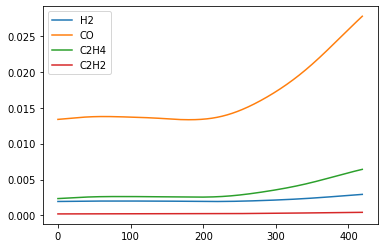

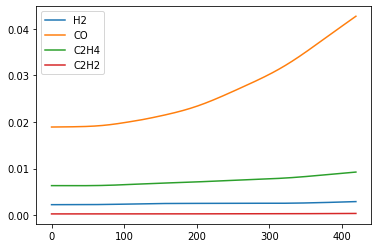

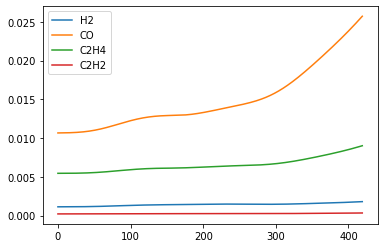

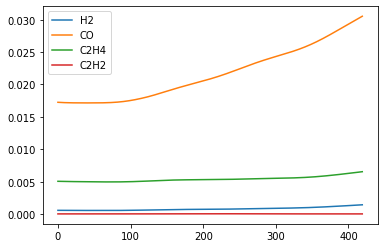

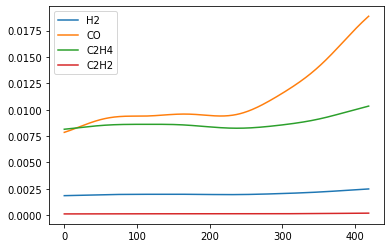

...

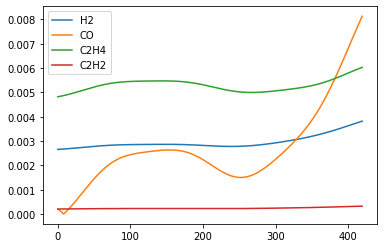

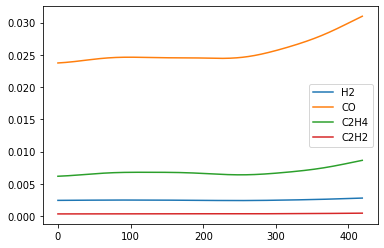

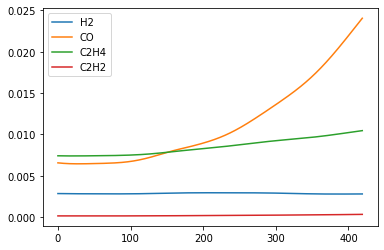

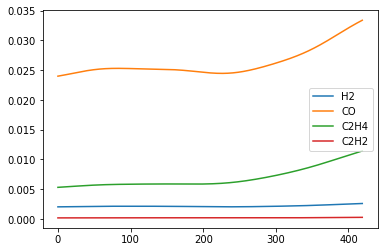

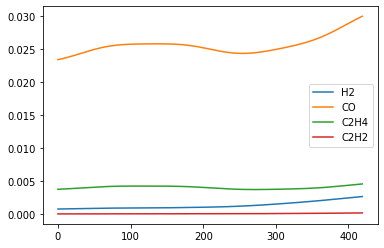

In [55]:
for file in files:
    pd.read_csv(file).plot()
    plt.show()

In [120]:
list_of_dfs = []
for file in files:
    list_of_cols = [pd.Series(col) for col in pd.read_csv(file).T.values]
#     list_of_cols.append(pd.read_csv(file).T.values[3] / 
#                         pd.read_csv(file).T.values[2])
#     list_of_cols.append(pd.read_csv(file).T.values[3] / 
#                         pd.read_csv(file).T.values[1])
#     list_of_cols.append(pd.read_csv(file).T.values[3] / 
#                         pd.read_csv(file).T.values[0])
    list_of_dfs.append(list_of_cols)

In [121]:
X = pd.DataFrame(list_of_dfs)

In [122]:
X_first_level = X.copy()

In [123]:
y_first_level = y.copy()
y_first_level[y_first_level>1] = 2

In [124]:
X_train, X_test, y_train, y_test = train_test_split(X_first_level, 
                                                    y_first_level, 
                                                    random_state=42, 
                                                    stratify=y_first_level)
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(1575, 4) (1575,) (525, 4) (525,)


### Time series concatenation + TimeSeriesForestClassifier

In [61]:
# , class_weight=dict(zip([1,2,3,4],(pd.Series(y).value_counts()/len(y)).values))

In [48]:
%%time

steps = [
    ("concatenate", ColumnConcatenator()),
    ("classify", TimeSeriesForestClassifier(n_estimators=100, n_jobs=-1, random_state=42)),
]
clf_first_level = Pipeline(steps)
clf_first_level.fit(X_train, y_train)
clf_first_level.score(X_test, y_test)

CPU times: user 13.9 s, sys: 2.68 s, total: 16.6 s
Wall time: 21.4 s


0.9657142857142857

In [49]:
y_pred = clf_first_level.predict(X_test)

print('\nClassification Report\n')
print(classification_report(y_test, y_pred, target_names=['Class 1', 'Class 2']))#, 'Class 3', 'Class 4']))


Classification Report

              precision    recall  f1-score   support

     Class 1       0.98      0.98      0.98       426
     Class 2       0.92      0.90      0.91        99

    accuracy                           0.97       525
   macro avg       0.95      0.94      0.94       525
weighted avg       0.97      0.97      0.97       525



### RISE

In [50]:
%%time
steps = [
    ("concatenate", ColumnConcatenator()),
    ("classify", RandomIntervalSpectralForest(random_state=42, n_jobs=-1)),
]
clf_first_level = Pipeline(steps)
clf_first_level.fit(X_train, y_train)
clf_first_level.score(X_test, y_test)

KeyboardInterrupt: 

In [51]:
y_pred = clf_first_level.predict(X_test)

print('\nClassification Report\n')
print(classification_report(y_test, y_pred, target_names=['Class 1', 'Class 2']))#, 'Class 3', 'Class 4']))

NotFittedError: This instance of RandomIntervalSpectralForest has not been fitted yet; please call `fit` first.

In [125]:
transformer_first_level = TSFreshFeatureExtractor(n_jobs=-1, show_warnings=False, default_fc_parameters="minimal")

X_train_tr_first_level = transformer_first_level.fit_transform(X_train)
X_test_tr_first_level = transformer_first_level.transform(X_test)

X_train_tr_first_level.head()

Feature Extraction: 100%|██████████| 70/70 [00:01<00:00, 39.96it/s]


,0__sum_values,0__median,0__mean,0__length,0__standard_deviation,0__variance,0__maximum,0__minimum,1__sum_values,1__median,...,2__maximum,2__minimum,3__sum_values,3__median,3__mean,3__length,3__standard_deviation,3__variance,3__maximum,3__minimum
254,0.244508,0.000525,0.000582,420.0,0.000321,1.032243e-07,0.001329,0.000218,3.656518,0.008745,...,0.015394,0.008654,0.138583,0.000319,0.000330,420.0,0.000040,1.561825e-09,0.000428,0.000289
1938,0.275026,0.000563,0.000655,420.0,0.000315,9.919405e-08,0.001497,0.000305,4.763450,0.011601,...,0.008250,0.007474,0.151411,0.000365,0.000361,420.0,0.000020,4.018377e-10,0.000404,0.000327
1632,1.036677,0.002472,0.002468,420.0,0.000071,5.004956e-09,0.002692,0.002326,8.412386,0.018642,...,0.005502,0.003527,0.098288,0.000234,0.000234,420.0,0.000005,2.151346e-11,0.000244,0.000226
2030,0.851211,0.002016,0.002027,420.0,0.000106,1.118980e-08,0.002398,0.001905,8.319947,0.018056,...,0.004495,0.002597,0.023590,0.000039,0.000056,420.0,0.000034,1.162195e-09,0.000161,0.000022
611,0.639594,0.001576,0.001523,420.0,0.000155,2.394718e-08,0.001838,0.001279,4.010854,0.008236,...,0.003670,0.002011,0.096632,0.000237,0.000230,420.0,0.000015,2.130048e-10,0.000249,0.000204


### Feature extraction with TSFRESH and random forest

In [126]:
%%time

clf_first_level = make_pipeline(
    RandomForestClassifier(n_jobs=-1, random_state=42)
)
clf_first_level.fit(X_train_tr_first_level, y_train)
clf_first_level.score(X_test_tr_first_level, y_test)

CPU times: user 368 ms, sys: 62 ms, total: 430 ms
Wall time: 162 ms


0.9561904761904761

In [127]:
y_pred = clf_first_level.predict(X_test_tr_first_level)

print('\nClassification Report\n')
print(classification_report(y_test, y_pred, target_names=['Class 1', 'Class 2']))#, 'Class 3', 'Class 4']))


Classification Report

              precision    recall  f1-score   support

     Class 1       0.97      0.98      0.97       426
     Class 2       0.91      0.85      0.88        99

    accuracy                           0.96       525
   macro avg       0.94      0.91      0.93       525
weighted avg       0.96      0.96      0.96       525



### Feature extraction with TSFRESH and extra trees

In [128]:
%%time

clf_first_level = make_pipeline(
#     TSFreshFeatureExtractor(n_jobs=-1, show_warnings=False), 
    ExtraTreesClassifier(n_jobs=-1, random_state=42)
)
clf_first_level.fit(X_train_tr_first_level, y_train)
clf_first_level.score(X_test_tr_first_level, y_test)

CPU times: user 179 ms, sys: 78.9 ms, total: 258 ms
Wall time: 136 ms


0.9561904761904761

In [129]:
y_pred = clf_first_level.predict(X_test_tr_first_level)

print('\nClassification Report\n')
print(classification_report(y_test, y_pred, target_names=['Class 1', 'Class 2']))#, 'Class 3', 'Class 4']))


Classification Report

              precision    recall  f1-score   support

     Class 1       0.97      0.98      0.97       426
     Class 2       0.90      0.86      0.88        99

    accuracy                           0.96       525
   macro avg       0.94      0.92      0.93       525
weighted avg       0.96      0.96      0.96       525



### Feature extraction with TSFRESH and adaboost

In [130]:
%%time

clf_first_level = make_pipeline(
#     TSFreshFeatureExtractor(n_jobs=-1, show_warnings=False), 
    AdaBoostClassifier(random_state=42)
)
clf_first_level.fit(X_train_tr_first_level, y_train)
clf_first_level.score(X_test_tr_first_level, y_test)

CPU times: user 250 ms, sys: 2.2 ms, total: 252 ms
Wall time: 251 ms


0.9638095238095238

In [131]:
y_pred = clf_first_level.predict(X_test_tr_first_level)

print('\nClassification Report\n')
print(classification_report(y_test, y_pred, target_names=['Class 1', 'Class 2']))#, 'Class 3', 'Class 4']))


Classification Report

              precision    recall  f1-score   support

     Class 1       0.98      0.98      0.98       426
     Class 2       0.90      0.91      0.90        99

    accuracy                           0.96       525
   macro avg       0.94      0.94      0.94       525
weighted avg       0.96      0.96      0.96       525



### Feature extraction with TSFRESH and catboost

In [132]:
%%time

clf_first_level = make_pipeline(
#     TSFreshFeatureExtractor(n_jobs=-1, show_warnings=False), 
    CatBoostClassifier(random_seed=42, 
                       verbose=False,)
)
clf_first_level.fit(X_train_tr_first_level, y_train)
clf_first_level.score(X_test_tr_first_level, y_test)

CPU times: user 20.6 s, sys: 486 ms, total: 21.1 s
Wall time: 2.44 s


0.9619047619047619

In [133]:
y_pred = clf_first_level.predict(X_test_tr_first_level)

print('\nClassification Report\n')
print(classification_report(y_test, y_pred, target_names=['Class 1', 'Class 2']))#, 'Class 3', 'Class 4']))


Classification Report

              precision    recall  f1-score   support

     Class 1       0.97      0.98      0.98       426
     Class 2       0.92      0.88      0.90        99

    accuracy                           0.96       525
   macro avg       0.94      0.93      0.94       525
weighted avg       0.96      0.96      0.96       525



In [106]:
X['target'] = y

In [108]:
X_second_level = X[X['target']>1].drop('target', axis=1)
y_second_level = X[X['target']>1]['target']

In [109]:
X_train, X_test, y_train, y_test = train_test_split(X_second_level, 
                                                    y_second_level, 
                                                    random_state=42, 
                                                    stratify=y_second_level)
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)

(296, 4) (296,) (99, 4) (99,)


In [114]:
transformer_second_level = TSFreshFeatureExtractor(n_jobs=-1, show_warnings=False, default_fc_parameters="minimal")

X_train_tr_second_level = transformer_second_level.fit_transform(X_train)
X_test_tr_second_level = transformer_second_level.transform(X_test)

X_train_tr_second_level.head()

Feature Extraction: 100%|██████████| 66/66 [00:01<00:00, 49.92it/s]


,0__sum_values,0__median,0__mean,0__length,0__standard_deviation,0__variance,0__maximum,0__minimum,1__sum_values,1__median,...,2__maximum,2__minimum,3__sum_values,3__median,3__mean,3__length,3__standard_deviation,3__variance,3__maximum,3__minimum
1463,0.806559,0.001785,0.001920,420.0,0.000440,1.936442e-07,0.002981,0.001416,1.363912,0.003111,...,0.000561,6.171985e-07,0.006974,0.000014,0.000017,420.0,0.000010,1.042287e-10,0.000031,0.000004
1217,0.902240,0.002071,0.002148,420.0,0.000266,7.084900e-08,0.002817,0.001852,2.964350,0.005192,...,0.002660,1.702515e-03,0.047903,0.000102,0.000114,420.0,0.000048,2.324323e-09,0.000231,0.000059
1307,0.987978,0.002100,0.002352,420.0,0.000455,2.071755e-07,0.003608,0.001942,4.124764,0.009817,...,0.007916,3.713914e-03,0.040573,0.000069,0.000097,420.0,0.000059,3.526045e-09,0.000244,0.000038
44,1.289261,0.003040,0.003070,420.0,0.000178,3.168871e-08,0.003614,0.002819,3.180611,0.007335,...,0.009928,5.081042e-03,0.083605,0.000200,0.000199,420.0,0.000004,1.675091e-11,0.000207,0.000190
174,0.117145,0.000240,0.000279,420.0,0.000206,4.251882e-08,0.000895,0.000021,1.625514,0.002839,...,0.010744,8.218676e-03,0.129551,0.000308,0.000308,420.0,0.000022,4.989436e-10,0.000372,0.000275


In [115]:
%%time

clf_second_level = make_pipeline(
    RandomForestClassifier(n_jobs=-1, random_state=42)
)
clf_second_level.fit(X_train_tr_second_level, y_train)
clf_second_level.score(X_test_tr_second_level, y_test)

CPU times: user 180 ms, sys: 57.7 ms, total: 237 ms
Wall time: 159 ms


0.8888888888888888

In [116]:
%%time

clf_second_level = make_pipeline(
#     TSFreshFeatureExtractor(n_jobs=-1, show_warnings=False), 
    CatBoostClassifier(random_seed=42, 
                       verbose=False,)
)
clf_second_level.fit(X_train_tr_second_level, y_train)
clf_second_level.score(X_test_tr_second_level, y_test)

CPU times: user 49 s, sys: 633 ms, total: 49.7 s
Wall time: 4.95 s


0.898989898989899

## Prediction for test set

In [97]:
import os
files = []
for dirname, _, filenames in os.walk('../data/raw/second_version/data_test/data_test/'):
    for filename in filenames:
        files.append(os.path.join(dirname, filename))

In [98]:
files.sort()

In [99]:
list_of_dfs = []
for file in files:
    list_of_cols = [pd.Series(col) for col in pd.read_csv(file).T.values]
    list_of_cols.append(pd.read_csv(file).T.values[3] / 
                        pd.read_csv(file).T.values[2])
    list_of_cols.append(pd.read_csv(file).T.values[3] / 
                        pd.read_csv(file).T.values[1])
    list_of_cols.append(pd.read_csv(file).T.values[3] / 
                        pd.read_csv(file).T.values[0])
    list_of_dfs.append(list_of_cols)

In [100]:
X_val = pd.DataFrame(list_of_dfs)

In [101]:
y_val = clf.predict(X_val)

Feature Extraction: 100%|██████████| 70/70 [01:41<00:00,  1.46s/it]


In [102]:
submission_df = pd.DataFrame({'id':[file.split('/')[-1] for file in files],
 'category':y_val[:,0]
}).set_index('id')

In [103]:
submission_df.head()

,category
id,
2_trans_1.csv,3
2_trans_10.csv,1
2_trans_1003.csv,1
2_trans_1004.csv,3
2_trans_1005.csv,1


In [104]:
submission_df.to_csv('../../submission10.csv')